In [ ]:
*Project 5 *
ID: CoronaVirus2019Dataset
Data: http://www.dei.unipd.it/~silvello/FIS2020/Covid19_data.zip
Additional: https://www.kaggle.com/sudalairajkumar/novel-corona-virus-2019-dataset
Additional data (Dec. 2020): http://www.dei.unipd.it/~silvello/FIS2020/COVID19Containmentmeasuresdata.csv
extra: http://epidemicforecasting.org/containment

Description: Looking at China's growth rate over time, we can clearly see that they were able to curb the growth rate of the virus. Over the last few weeks, different countries have performed different forms of mitigation to do the same: ban large gatherings, close schools, stop incoming flights, put cities in lockdown, etc.
The task is to evaluate the effectiveness of mitigation by trying to see if a correlation can be discovered between the different types of mitigation and the growth rate of confirmed cases. What measures seem to work and which not? Which ones are the most effective? Keep in mind there are numerous factors that might affect the growth rate (e.g. country's general hygiene, population density, how much time they had to prepare) so not all countries can be compared easily. China being an obvious outlier since it was country 0. Output:
A Python notebook reporting the conducted analyses and a summary of the conclusions achieved by the conducted correlation analysis.


# Authors: Sara Kartalovic, Sercan Albut

In [13]:
open_line_list = open_line_list.replace(np.nan, 'NULL')
covid_19_data = covid_19_data.replace(np.nan, 'NULL')

In [14]:
open_line_list

,city,province,country,wuhan(0)_not_wuhan(1),date_confirmation,lives_in_Wuhan
0,"Chaohu City, Hefei City",Anhui,China,1,22.01.2020,yes
1,"Baohe District, Hefei City",Anhui,China,1,23.01.2020,no
2,"High-Tech Zone, Hefei City",Anhui,China,1,23.01.2020,no
3,"High-Tech Zone, Hefei City",Anhui,China,1,23.01.2020,no
4,"Feidong County, Hefei City",Anhui,China,1,23.01.2020,no
...,...,...,...,...,...,...
13169,Nagoya City,Aichi Prefecture,Japan,1,28.02.2020,NULL
13170,NULL,Osaka,Japan,1,28.02.2020,NULL
13171,NULL,Osaka,Japan,1,28.02.2020,NULL
13172,Amsterdam,NULL,Netherlands,1,28.02.2020,NULL


In [15]:
open_line_list.describe()

,city,province,country,wuhan(0)_not_wuhan(1),date_confirmation,lives_in_Wuhan
count,13174,13174,13174,13174.0,13174,13174
unique,807,151,52,2.0,48,22
top,NULL,Guangdong,China,1.0,29.01.2020,NULL
freq,2980,1228,10446,13170.0,1091,12609


In [16]:
confirmed

,Province/State,Country/Region,1/22/20,1/23/20,1/24/20,1/25/20,1/26/20,1/27/20,1/28/20,1/29/20,...,9/14/20,9/15/20,9/16/20,9/17/20,9/18/20,9/19/20,9/20/20,9/21/20,9/22/20,9/23/20
0,NaN,Afghanistan,0,0,0,0,0,0,0,0,...,38772,38815,38855,38872,38883,38919,39044,39074,39096,39145
1,NaN,Albania,0,0,0,0,0,0,0,0,...,11520,11672,11816,11948,12073,12226,12385,12535,12666,12787
2,NaN,Algeria,0,0,0,0,0,0,0,0,...,48496,48734,48966,49194,49413,49623,49826,50023,50214,50400
3,NaN,Andorra,0,0,0,0,0,0,0,0,...,1438,1438,1483,1483,1564,1564,1564,1681,1681,1753
4,NaN,Angola,0,0,0,0,0,0,0,0,...,3439,3569,3675,3789,3848,3901,3991,4117,4236,4363
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
261,NaN,West Bank and Gaza,0,0,0,0,0,0,0,0,...,31362,32250,33006,33843,34401,35003,35686,36151,36580,37083
262,NaN,Western Sahara,0,0,0,0,0,0,0,0,...,10,10,10,10,10,10,10,10,10,10
263,NaN,Yemen,0,0,0,0,0,0,0,0,...,2013,2016,2019,2022,2024,2026,2026,2028,2028,2029
264,NaN,Zambia,0,0,0,0,0,0,0,0,...,13720,13819,13887,13928,14022,14070,14131,14175,14389,14443


In [8]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import matplotlib.animation as animation
import matplotlib.colors as mc
import seaborn as sns
import matplotlib.dates as mdates
import calendar
import colorsys
from IPython.display import HTML
from datetime import datetime
from random import randint

In [9]:
# Data import
covid_19_data = pd.read_csv('project/covid_19_data_cleaned.csv')
open_line_list = pd.read_csv('project/open_line_list_cleaned.csv')
containment_measure_data = pd.read_csv('project/COVID19Containmentmeasuresdata_cleaned.csv')
line_list_data = pd.read_csv('project/COVID19_line_list_data_cleaned.csv')
confirmed_USA = pd.read_csv('project/time_series_covid_19_confirmed_US_cleaned_City_rm.csv')
confirmed = pd.read_csv('project/time_series_covid_19_confirmed_cleaned.csv')
confirmed_weekly = pd.read_csv('project/time_series_covid_19_confirmed_cleaned_provinces_rm_weekly.csv', sep = ";")

In [10]:
# Extract Mainland China from the DataFrame
mainland_china = covid_19_data['Country/Region'] == 'Mainland China'

In [11]:
# Extract confirmed cases in Mainland China
conf = covid_19_data['Confirmed'].where(mainland_china).cumsum()
conf = conf.dropna()
conf

0                1.0
1               15.0
2               21.0
3               22.0
4               22.0
             ...    
116721    18895054.0
116722    18895055.0
116788    18895957.0
116796    18896166.0
116802    18897448.0
Name: Confirmed, Length: 7624, dtype: float64

In [12]:
# Extract the dates when there were confirmed cases in Mainland China
dates = covid_19_data['ObservationDate'].where(mainland_china)
dates = dates.dropna()
dates

0         01/22/2020
1         01/22/2020
2         01/22/2020
3         01/22/2020
4         01/22/2020
             ...    
116721    09/23/2020
116722    09/23/2020
116788    09/23/2020
116796    09/23/2020
116802    09/23/2020
Name: ObservationDate, Length: 7624, dtype: object

CORRECT PLOTS
Change the index to be the date

In [13]:
#DataFrame grouped by Country/Region and ObservaionDate
new_covid_19_data = pd.DataFrame(covid_19_data.groupby(['Country/Region','ObservationDate'])['Confirmed'].sum()).reset_index()

In [14]:
new_covid_19_data.head()

,Country/Region,ObservationDate,Confirmed
0,Azerbaijan,02/28/2020,1
1,"('St. Martin',)",03/10/2020,2
2,Afghanistan,02/24/2020,1
3,Afghanistan,02/25/2020,1
4,Afghanistan,02/26/2020,1


In [15]:
mc = new_covid_19_data["Country/Region"] == "Mainland China"
mc

0        False
1        False
2        False
3        False
4        False
         ...  
38826    False
38827    False
38828    False
38829    False
38830    False
Name: Country/Region, Length: 38831, dtype: bool

In [16]:
mc_conf = new_covid_19_data['Confirmed'].where(mc)
mc_conf = mc_conf.dropna()
mc_conf

21543      547.0
21544      639.0
21545      916.0
21546     1399.0
21547     2062.0
          ...   
21784    85279.0
21785    85291.0
21786    85297.0
21787    85307.0
21788    85314.0
Name: Confirmed, Length: 246, dtype: float64

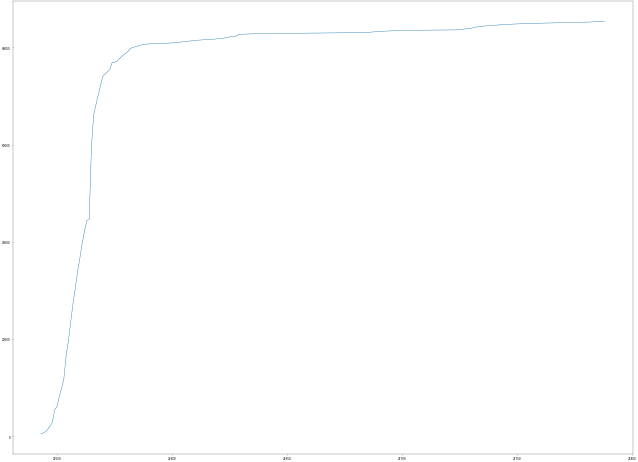

In [17]:
#Change the plot size
plt.figure(figsize=(40, 30), dpi = 20)
#figure(num=None, figsize=(8, 6), dpi=80, facecolor='w', edgecolor='k')
mc_conf.plot().figure.savefig('test1png.png', dpi=20)

In [18]:
# Russia
r = new_covid_19_data["Country/Region"] == "Russia"

In [19]:
r_conf = new_covid_19_data['Confirmed'].where(r)
r_conf = r_conf.dropna()
r_conf

28816          2.0
28817          2.0
28818          2.0
28819          2.0
28820          2.0
           ...    
29048    1092915.0
29049    1098958.0
29050    1105048.0
29051    1111157.0
29052    1117487.0
Name: Confirmed, Length: 237, dtype: float64

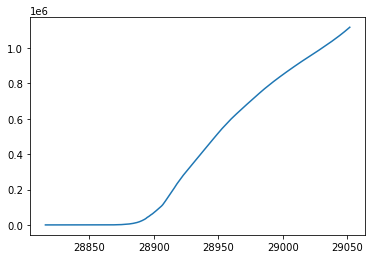

In [20]:
r_conf.plot()

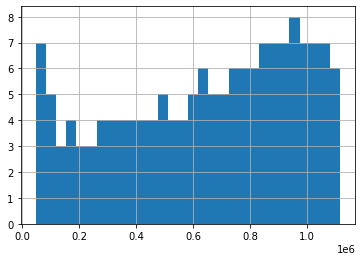

In [21]:
r_conf[80:].hist(bins = 30)

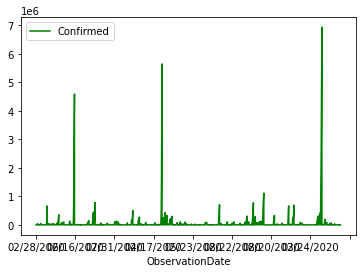

In [22]:
new_covid_19_data.plot(kind = "line", x = "ObservationDate", y = "Confirmed", color = "green")

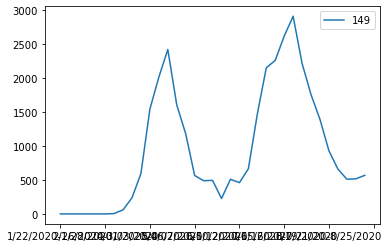

In [23]:
#Correct graph of Serbia
srb = confirmed_weekly.iloc[149:150].T
srb.iloc[1:].plot()

In [24]:
#Extract Serbia and create a new dataframe
df = pd.DataFrame(confirmed_weekly[149:150])

#add Montenegro to the dataframe
df = df.append(confirmed_weekly[77:78])

#Transpose matrix
df = df.T

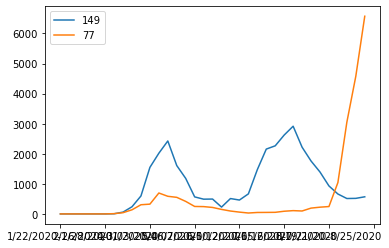

In [25]:
# Correct comparison plot of Serbia and Montenegro
df.iloc[1:].plot()

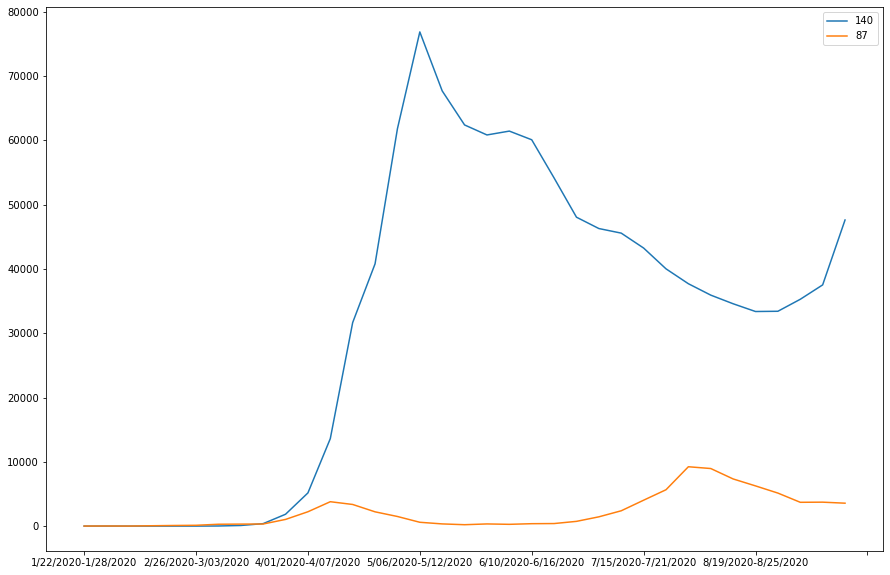

In [26]:
# Russia and Japan
russia_usa = pd.DataFrame(confirmed_weekly[140:141])
russia_usa = russia_usa.append(confirmed_weekly[87:88])
russia_usa = russia_usa.T
russia_usa.iloc[1:].plot(figsize=(15, 10))

([<matplotlib.axis.XTick at 0x1d4059c3d00>,
 [Text(0, 0, ''),
  Text(0, 0, 'Week 1'),
  Text(0, 0, 'Week 2'),
  Text(0, 0, 'Week3'),
  Text(0, 0, 'Week 4'),
  Text(0, 0, 'Week 5'),
  Text(0, 0, 'Week 6'),
  Text(0, 0, 'Week 7'),
  Text(0, 0, 'Week 8'),
  Text(0, 0, 'Week 9'),
  Text(0, 0, 'Week 10'),
  Text(0, 0, 'Week 11'),
  Text(0, 0, 'Week 12'),
  Text(0, 0, 'Week 13'),
  Text(0, 0, 'Week 14'),
  Text(0, 0, 'Week 15'),
  Text(0, 0, 'Week 16'),
  Text(0, 0, 'Week 17'),
  Text(0, 0, 'Week 18'),
  Text(0, 0, 'Week 19'),
  Text(0, 0, 'Week 20'),
  Text(0, 0, 'Week 21'),
  Text(0, 0, 'Week 22'),
  Text(0, 0, 'Week 23'),
  Text(0, 0, 'Week 24'),
  Text(0, 0, 'Week 25'),
  Text(0, 0, 'Week 26'),
  Text(0, 0, 'Week 27'),
  Text(0, 0, 'Week 28'),
  Text(0, 0, 'Week 29'),
  Text(0, 0, 'Week 30'),
  Text(0, 0, 'Week 31'),
  Text(0, 0, 'Week 32'),
  Text(0, 0, 'Week 33'),
  Text(0, 0, 'Week 34')])

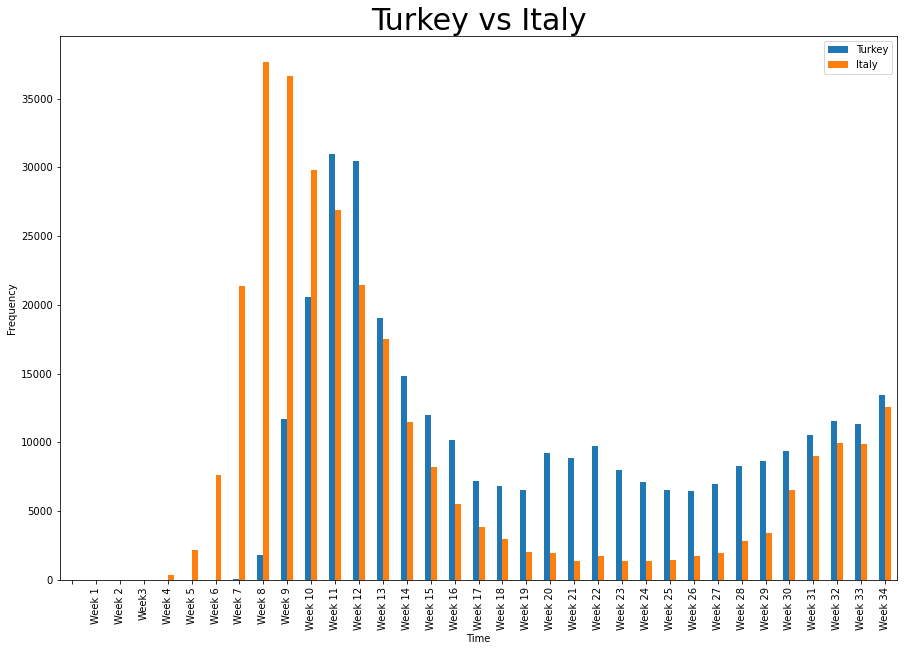

In [27]:
# Turkey and Italy
turkey_italy = pd.DataFrame(confirmed_weekly[173:174])
turkey_italy = turkey_italy.append(confirmed_weekly[85:86])
turkey_italy = turkey_italy.T

# Plot 
turkey_italy_plot = turkey_italy[1:].plot(figsize=(15, 10), kind="bar")

#### Graph Design

# Change the legend
plt.legend(['Turkey', 'Italy'])

#Add title
plt.title(label = 'Turkey vs Italy', 
          size = 30)

# Add labels
plt.xlabel('Time')
plt.ylabel('Frequency')

# Change x-axis labels
locs, labels = plt.xticks()
plt.xticks(locs , ['', 'Week 1', 'Week 2', 'Week3' , 'Week 4', 'Week 5', 'Week 6', 'Week 7' 
                   , 'Week 8', 'Week 9', 'Week 10', 'Week 11', 'Week 12', 'Week 13', 'Week 14', 
                   'Week 15','Week 16','Week 17','Week 18','Week 19','Week 20','Week 21',
                   'Week 22','Week 23','Week 24','Week 25','Week 26','Week 27','Week 28',
                   'Week 29','Week 30','Week 31','Week 32','Week 33','Week 34','Week 35',])

([<matplotlib.axis.XTick at 0x1d4057cb430>,
 [Text(0, 0, ''),
  Text(0, 0, 'Week 1'),
  Text(0, 0, 'Week 6'),
  Text(0, 0, 'Week 11'),
  Text(0, 0, 'Week 16'),
  Text(0, 0, 'Week 21'),
  Text(0, 0, 'Week 26'),
  Text(0, 0, 'Week 31'),
  Text(0, 0, 'Week 35')])

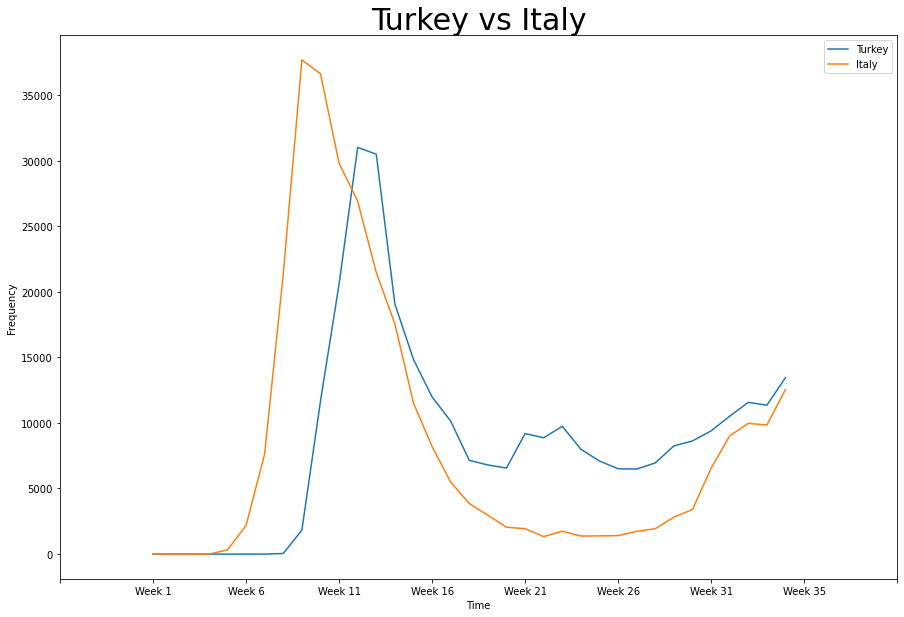

In [28]:
# Turkey and Italy
turkey_italy = pd.DataFrame(confirmed_weekly[173:174])
turkey_italy = turkey_italy.append(confirmed_weekly[85:86])
turkey_italy = turkey_italy.T

# Plot 
turkey_italy_plot = turkey_italy[1:].plot(figsize=(15, 10))

#### Graph Design

# Change the legend
plt.legend(['Turkey', 'Italy'])

#Add title
plt.title(label = 'Turkey vs Italy', 
          size = 30)

# Add labels
plt.xlabel('Time')
plt.ylabel('Frequency')

# Change x-axis labels
locs, labels = plt.xticks()
plt.xticks(locs , ['', 'Week 1', 'Week 6', 'Week 11', 'Week 16', 'Week 21', 'Week 26', 'Week 31','Week 35'])

If we look at the data of Italy and Turkey, we can easly see the rapid increase at the beginning. According to news sources and data these 2 countries were poor to respond to a global pandemic. Comparing these two countries are important because their population, economic statues and social behaviours are more or less the same. Both countries have mediterranian culture which makes people more social out going and spending time in the outdoors. Even after first serious wave , both governmetns had hard time to contain people. Quarantines, lockdowns and red zones were more than anyother country. Phone applications were created to track people on the issue of containment and covid spread. We can say these two countries had the strongest mitigation measurements. That is why afer march there has been a rapid decrease on both countries data. This data frame and plot is the proof to say that mitigations worked even though both countries had late response and have hard to control social structure.

#Animation gragh

In [29]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import matplotlib.animation as animation
import numpy as np
import matplotlib.colors as mc
import seaborn as sns
import colorsys
from IPython.display import HTML
from datetime import datetime
from random import randint

In [30]:
df = covid_19_data
df = pd.DataFrame(df.groupby(['Country/Region','ObservationDate'])['Confirmed'].sum()).reset_index()
current_date = '02/28/2020'
dff = df[df['ObservationDate'].eq(current_date)].sort_values(by='Confirmed', ascending=False).head(15)

<BarContainer object of 15 artists>

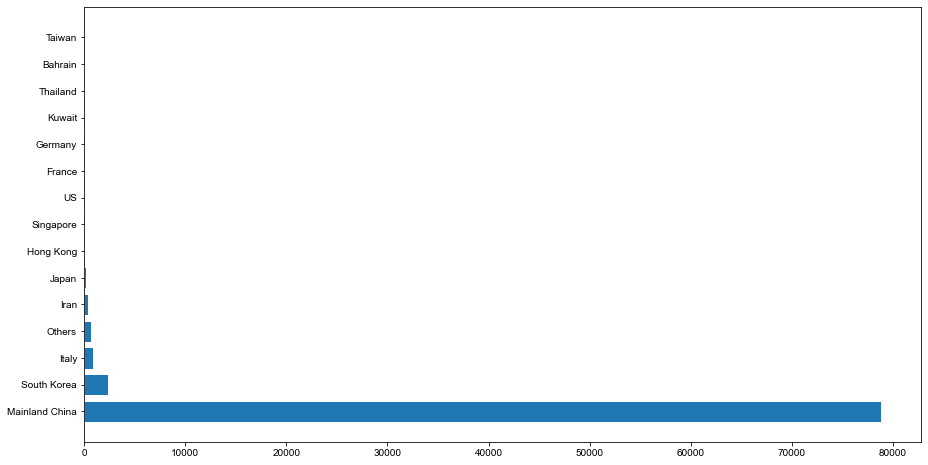

In [31]:
fig, ax = plt.subplots(figsize=(15, 8))
sns.set(style="darkgrid")
ax.barh(dff['Country/Region'], dff['Confirmed'])

In [32]:
def transform_color(color, amount = 0.5):
    try:
        c = mc.cnames[color]
    except:
        c = color
        c = colorsys.rgb_to_hls(*mc.to_rgb(c))
    return colorsys.hls_to_rgb(c[0], 1 - amount * (1 - c[1]), c[2])
all_names = df['Country/Region'].unique().tolist()
random_hex_colors = []
for i in range(len(all_names)):
    random_hex_colors.append('#' + '%06X' % randint(0, 0xFFFFFF))
    
rgb_colors = [transform_color(i, 1) for i in random_hex_colors]
rgb_colors_opacity = [rgb_colors[x] + (0.325,) for x in range(len(rgb_colors))]

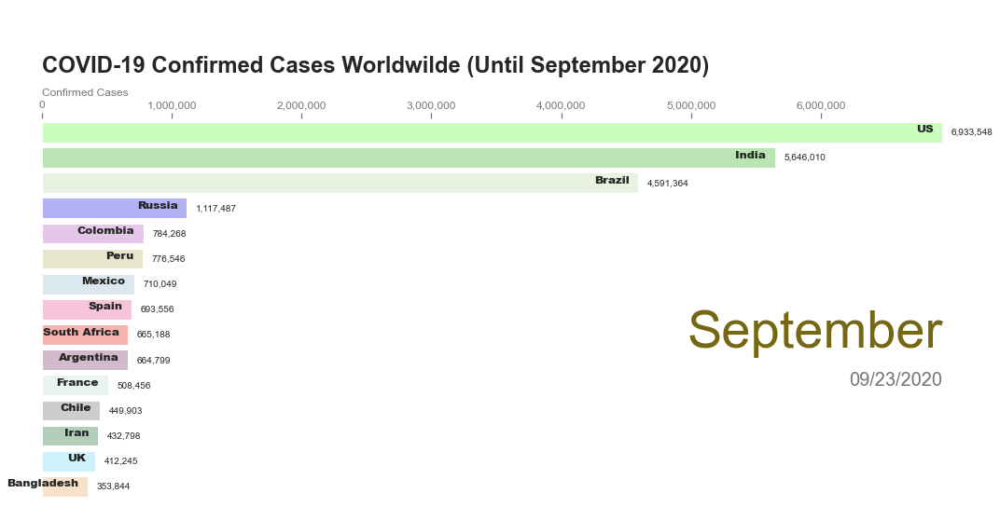

In [33]:
from datetime import datetime

fig, ax = plt.subplots(figsize=(15,8))
fig.subplots_adjust(left=0, bottom=0, right=1, top=1, wspace=None, hspace=None)

def draw_barchart(date):
    dff = df[df['ObservationDate'].eq(date)].sort_values(by='Confirmed', ascending=True).tail(15)
    ax.clear()
    
    normal_colors = dict(zip(df['Country/Region'].unique(), rgb_colors_opacity))
    
    ax.barh(dff['Country/Region'], dff['Confirmed'], color = [normal_colors[x] for x in dff['Country/Region']])
    dx = dff['Confirmed'].max() / 100
    for i, (value, name) in enumerate(zip(dff['Confirmed'], dff['Country/Region'])):
        ax.text(value-dx, i,     name,           size=12, weight=800, ha='right')
        ax.text(value+dx, i,     f'{value:,.0f}',  size=10, ha='left',  va='center')
        
    # ... polished styles
    ax.text(1, 0.4, datetime.strptime(date, '%m/%d/%Y').strftime("%B"), transform=ax.transAxes, color='#766712', size=56, ha='right', weight=500)
    ax.text(1, 0.3, date, transform=ax.transAxes, color='#777777', size=20, ha='right', weight=500)
    ax.text(0, 1.06, 'Confirmed Cases', transform=ax.transAxes, size=12, color='#777777')
    ax.xaxis.set_major_formatter(ticker.StrMethodFormatter('{x:,.0f}'))
    ax.xaxis.set_ticks_position('top')
    ax.tick_params(axis='x', colors='#777777', labelsize=12)
    ax.set_yticks([])
    ax.margins(0, 0.01)
    ax.grid(which='major', axis='x', linestyle='-')
    ax.set_axisbelow(True)
    ax.text(0, 1.12, '\n\nCOVID-19 Confirmed Cases Worldwilde (Until September 2020)', transform=ax.transAxes, size=24, weight=600, ha='left')
    plt.box(False)
    plt.tight_layout()
    
draw_barchart('09/23/2020')

In [34]:
dates=pd.Series(df['ObservationDate'].unique())
dates = dates.sort_values()

dates=dates.where(dates < '09/23/2020')

dates.sort_values(ascending=True)

dates.dropna(inplace=True)
dates = dates.astype(str)
dates

245    01/22/2020
213    01/23/2020
244    01/24/2020
214    01/25/2020
215    01/26/2020
          ...    
207    09/18/2020
208    09/19/2020
209    09/20/2020
210    09/21/2020
211    09/22/2020
Length: 245, dtype: object

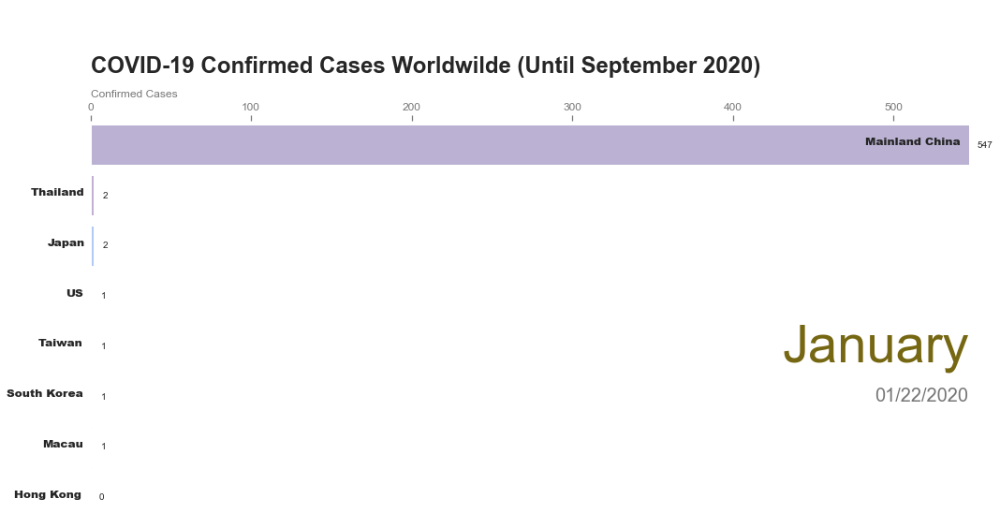

In [36]:
import matplotlib.animation as animation
from IPython.display import HTML

fig, ax = plt.subplots(figsize=(15, 8 ))
animator = animation.FuncAnimation(fig, draw_barchart, frames=dates)
HTML(animator.to_jshtml())
#animator.save('covid_till_september.gif', writer='SSS', fps=10)

SARA's PLOTS

France VS Germany
A decision to compare these two countries is based on their similar economic status and population density.

It seems that France was handling the COVID-19 outbreak better than Germany towards the end of March, but even though the number of confirmed cases in France started decreasing, soon it started rapidly increasing again. By looking at the containment measures that both of these countries took, we can conclude that Germany made a smart move by closing the borders with France, Switzerland, Austria, Denmark, and Luxembourg on March 16th. With both countries having their schools, restaurant, and shops closed, the only other difference that may have had helped Germany to stop the spreading of the Coronavirus may be the German government's decision to forbid all gatherings of more than two people on March 22nd. These two containment measures are the main difference and maybe the reason why Germany had the number of infected people under control.

Text(0, 0.5, 'Number of Confirmed Cases')

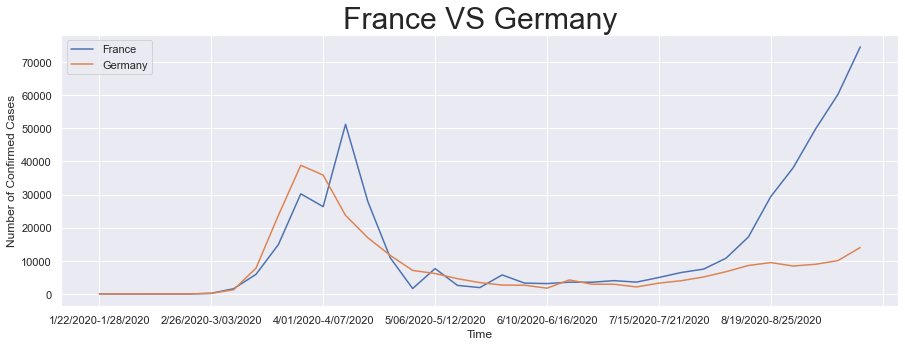

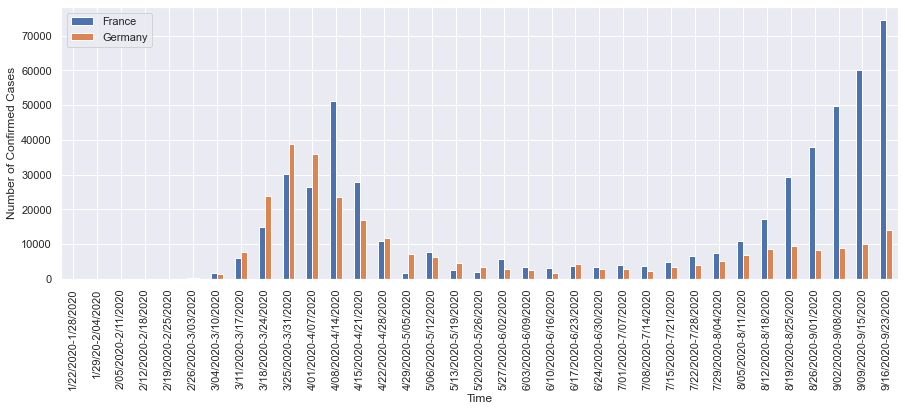

In [37]:
# France and Germany DataFrame
france_germany = pd.DataFrame(confirmed_weekly[62:63])
france_germany = france_germany.append(confirmed_weekly[66:67])
france_germany = france_germany.T

# Plot grouped by week
france_germany_plot = france_germany[1:].plot(figsize=(15, 5))

# Change the legend of the line plot
plt.legend(['France', 'Germany'])

#Add title
plt.title(label = 'France VS Germany', 
          size = 30)

# Add labels to the line plot
plt.xlabel('Time')
plt.ylabel('Number of Confirmed Cases')

#####################################################################################

# Histogram grouped by week
france_germany_plot = france_germany[1:].plot(figsize=(15, 5), kind = 'bar')

# Change the legend of the histogram
plt.legend(['France', 'Germany'])

# Add labels to the histogram
plt.xlabel('Time')
plt.ylabel('Number of Confirmed Cases')

Serbia VS Portugal
A decision to compare these two countries is based on the time of the first confirmed case.

Both countries have had alsmost same time to prepare, and in both countries starting from mid-March gatherings were prohibited, schools and nurseries were closed as well as shopping malls, museums, and restaurants. Even though Serbia's first confirmed case was registered a few days after the first case was confirmed in Portugal, Serbia was the first one to declare a state of emergency on March 15th, five days before Portugal. Another reason why Serbia's confirmed cases started dropping sooner is that Serbia closed all the borders on the March 18th to all foreigners not living in Serbia; furthermore, two days later, all the border crossings were closed for traffic, except for trucks transporting goods.

Text(0, 0.5, 'Number of Confirmed Cases')

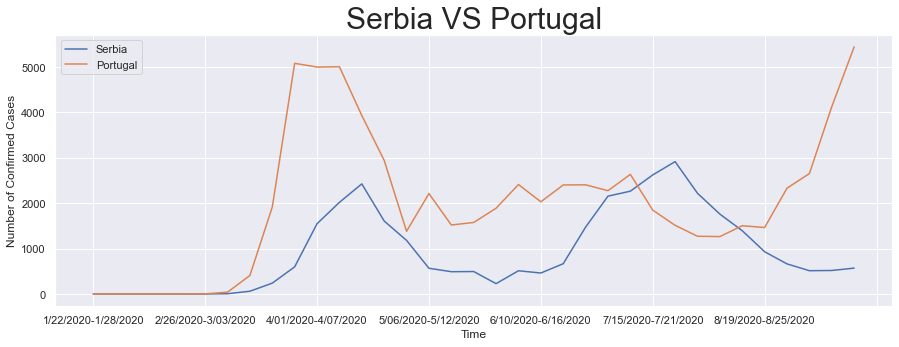

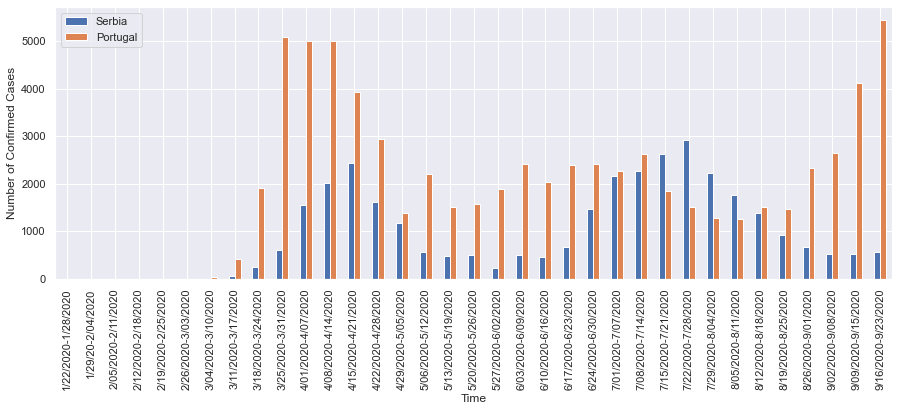

In [38]:
# Serbia and Portugal DataFrame 
serbia_portugal = pd.DataFrame(confirmed_weekly[149:150])
serbia_portugal = serbia_portugal.append(confirmed_weekly[137:138])
serbia_portugal = serbia_portugal.T

# Plot grouped by week
serbia_portugal_plot = serbia_portugal[1:].plot(figsize=(15, 5))

# Change the legend of the lineplot
plt.legend(['Serbia', 'Portugal'])

#Add title
plt.title(label = 'Serbia VS Portugal', 
          size = 30)

# Add labels to the line plot
plt.xlabel('Time')
plt.ylabel('Number of Confirmed Cases')

#####################################################################################

# Histogram grouped by week
serbia_portugal_plot = serbia_portugal[1:].plot(figsize=(15, 5), kind = 'bar')

# Change the legend of the histogram
plt.legend(['Serbia', 'Portugal'])

# Add labels to the histogram
plt.xlabel('Time')
plt.ylabel('Number of Confirmed Cases')

Netherlands VS Sweden
A decision to compare these two countries is based on their similar economic and social status.

The Netherlands made a good move by canceling all events, closing universities and schools along with restaurants, coffee shops, and sports clubs in the middle of March, shortly after the first confirmed case, while Sweden's good move was passing a new law, temporarily banning all gatherings larger than 500 people, with the threat of fine and prison. When the number of confirmed cases started increasing, Netherlands canceled all flights from China, Iran, Italy, and South Korea, the countries with the highest number of coronavirus cases, for two weeks starting from March 13th. On March 23rd, all gatherings in the Netherlands were forbidden up until June 1st, while Sweden did not take this measure. This may be the reason why Sweden had the most confirmed cases later on and during the summertime.



Text(0, 0.5, 'Number of Confirmed Cases')

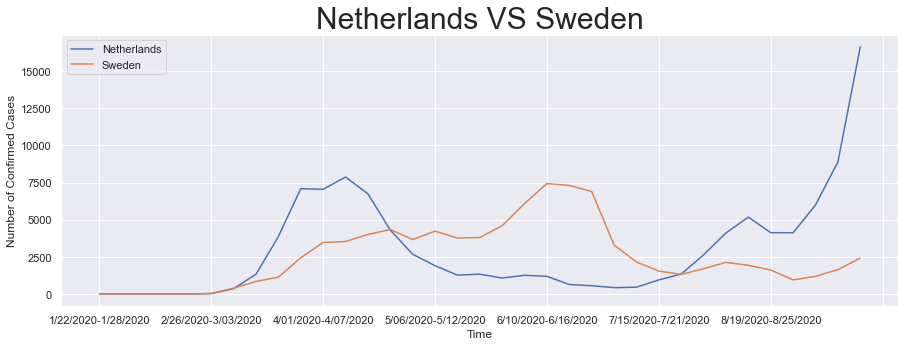

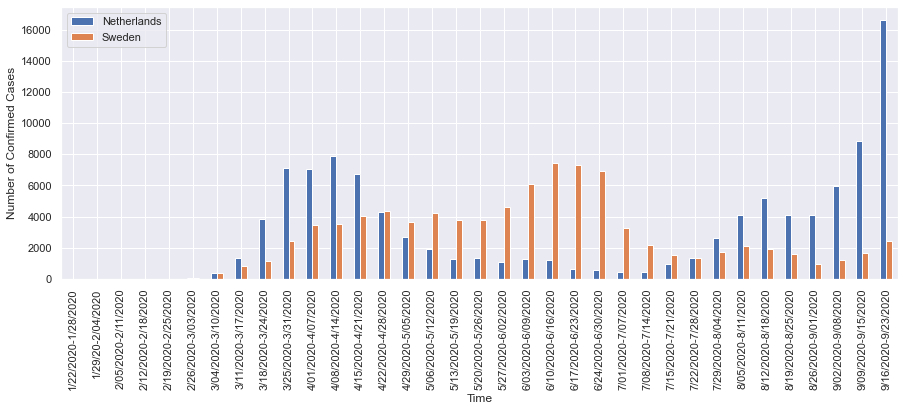

In [39]:
# Netherlands and Sweden DataFrame
netherlands_sweden = pd.DataFrame(confirmed_weekly[122:123])
netherlands_sweden = netherlands_sweden.append(confirmed_weekly[162:163])
netherlands_sweden = netherlands_sweden.T

# Plot grouped by week
netherlands_sweden_plot = netherlands_sweden[1:].plot(figsize=(15, 5))
#### Graph Design

# Change the legend of the line plot
plt.legend(['Netherlands', 'Sweden'])

#Add title
plt.title(label = 'Netherlands VS Sweden', 
          size = 30)

# Add labels to the line plot
plt.xlabel('Time')
plt.ylabel('Number of Confirmed Cases')

#####################################################################################

# Histogram grouped by week
netherlands_sweden_plot = netherlands_sweden[1:].plot(figsize=(15, 5), kind = 'bar')

# Change the legend of the histogram
plt.legend(['Netherlands', 'Sweden'])

# Add labels to the histogram
plt.xlabel('Time')
plt.ylabel('Number of Confirmed Cases')

South Korea VS Spain
A decision to compare these two countries is based on population density.

From the graphs we can conclude that South Korea had the COVID-19 virus under control. By taking numerous measures early on, they ensured the safety of citizens. Some of those measures were testing people with symptoms even though they did not travel and required isolation for people with sympotms even before they were tested. Next, disinfecting public spaces, providing e-learning resources to students for free so students can preview contents before the semester begins, allocating 'monitoring centre' in national accommodation facilities or hotels for patiens that have just been released, setting up Mask Supply App service commenced that informs and alerts local pharmacies mask supply situations to citizens, nationally increased disinfecting, santising, ventilation processes in confined facilities, Special Entry Measure extended to students from countries with high number of confirmed cases, etc. On the other hand, it looks that Spain waited for the last moment to take any measures which resulted in the high number of confirmed cases shortly after the first death of COVID-19 patient. Quarantine for some people, closing schools and shops, and canceling events and elections was not done on time, neither borders were closed, which automaticaly meant that the virus would spread rapidly.

Text(0, 0.5, 'Number of Confirmed Cases')

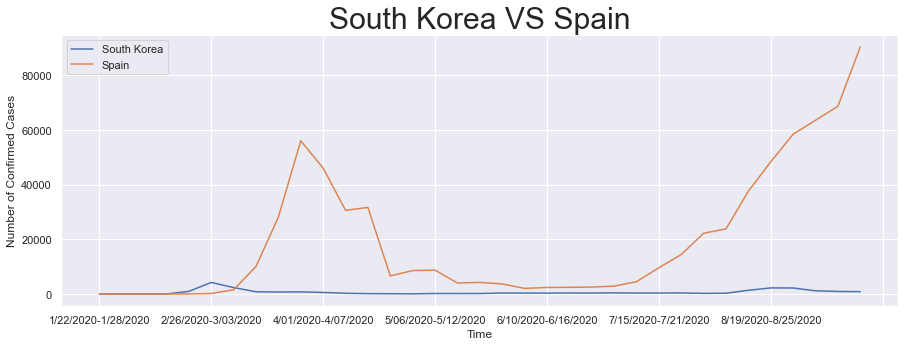

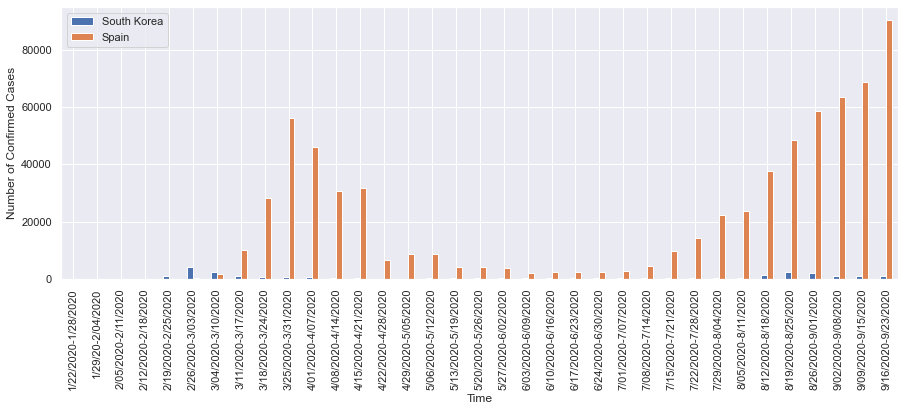

In [40]:
# South Korea and Spain DataFrame
sk_spain = pd.DataFrame(confirmed_weekly[91:92])
sk_spain = sk_spain.append(confirmed_weekly[158:159])
sk_spain = sk_spain.T

# Plot grouped by week
sk_spain_plot = sk_spain[1:].plot(figsize=(15, 5))
#### Graph Design

# Change the legend of the line plot
plt.legend(['South Korea', 'Spain'])

#Add title
plt.title(label = 'South Korea VS Spain', 
          size = 30)

# Add labels to the line plot
plt.xlabel('Time')
plt.ylabel('Number of Confirmed Cases')

#####################################################################################

# Histogram grouped by week
sk_spain_plot = sk_spain[1:].plot(figsize=(15, 5), kind = 'bar')

# Change the legend of the line plot
plt.legend(['South Korea', 'Spain'])

# Add labels to the histogram
plt.xlabel('Time')
plt.ylabel('Number of Confirmed Cases')

United Kingdom VS Canada
A decision to compare these two countries is based on their population density and economical status.

It looks that both countries did not take any serious contentment measurements. Mask, isolation, and voluntary home quarantine were recommended for people who entered the country and have mild symptoms but not mandatory. The main difference is that the UK stopped testing people who are self-isolating with mild symptoms on March 14th. From the graph, we can see that the number of confirmed cases started rapidly growing which may have been the result of not testing individuals with symptoms and that this containment measure did not work quite well.

Text(0, 0.5, 'Number of Confirmed Cases')

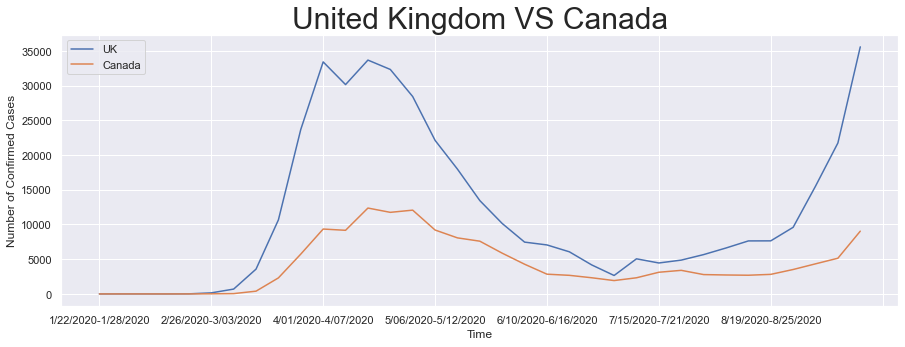

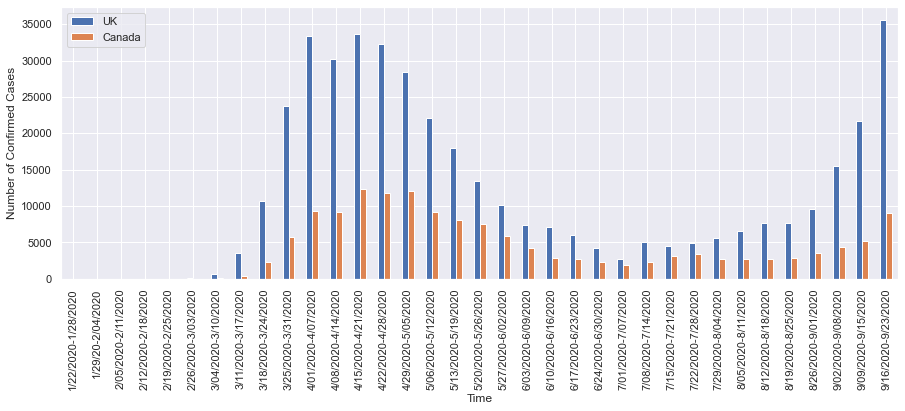

In [41]:
# UK and Canada DataFrame
uk_canada = pd.DataFrame(confirmed_weekly[178:179])
uk_canada = uk_canada.append(confirmed_weekly[32:33])
uk_canada = uk_canada.T

# Plot grouped by week
uk_canada_plot = uk_canada[1:].plot(figsize=(15, 5))
#### Graph Design

# Change the legend of the line plot
plt.legend(['UK', 'Canada'])

#Add title
plt.title(label = 'United Kingdom VS Canada', 
          size = 30)

# Add labels to the line plot
plt.xlabel('Time')
plt.ylabel('Number of Confirmed Cases')

#####################################################################################

# Histogram grouped by week
uk_canada_plot = uk_canada[1:].plot(figsize=(15, 5), kind = 'bar')

# Change the legend of the line plot
plt.legend(['UK', 'Canada'])

# Add labels to the histogram
plt.xlabel('Time')
plt.ylabel('Number of Confirmed Cases')

SHEHROZ's PLOTS
Hungary VS Estonia
These two countries are almost similar economy-wise, they are economically strong and capable of amending measures if needed.

Authorities in Estonia have amended measures for travelers arriving in the country according to an announcement made on Jan. 7th. From Jan. 15th even before their first confirmed case which was on February 27th, 2020.

While, Hungary responded right after their first two confirmed cases which were on March 4th, 2020. They started canceling international flights and closing borders for all foreigners and so on.

As we can see that Estonia was well prepared during the peak of the spread. Statistics show that Estonia was quite stable where there was a big raise in the confirmed cases in Hungary later on.

Text(0, 0.5, 'Number of Confirmed Cases')

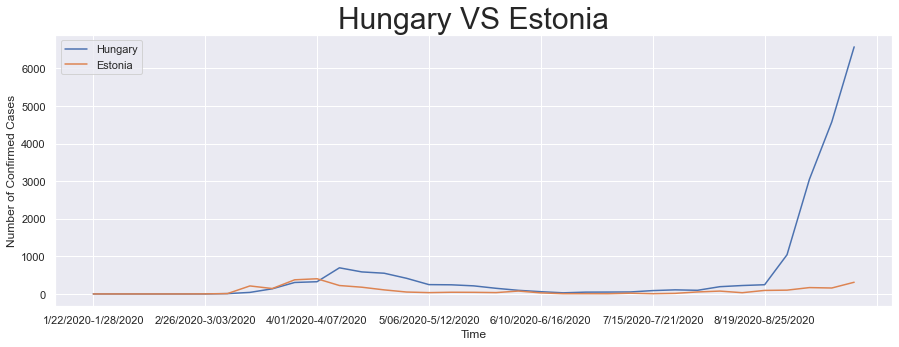

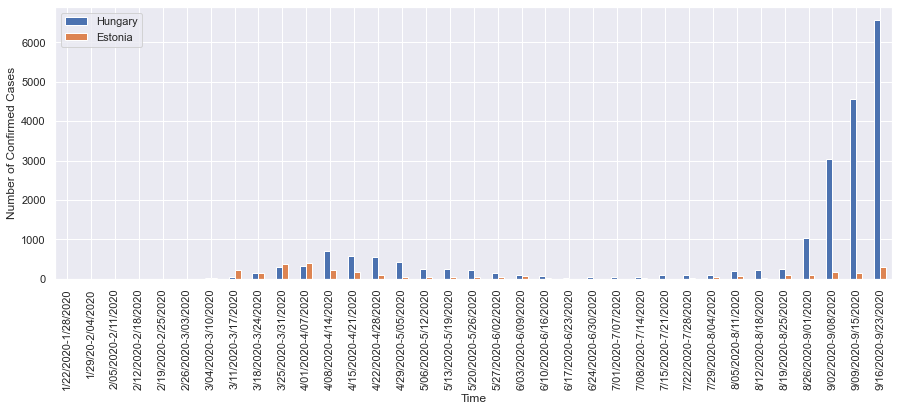

In [42]:
# Hungary and Estonia DataFrame 
Hungary_Estonia = pd.DataFrame(confirmed_weekly[77:78])
Hungary_Estonia = Hungary_Estonia.append(confirmed_weekly[57:58])

Hungary_Estonia = Hungary_Estonia.T

# Plot grouped by week
Hungary_Estonia_plot = Hungary_Estonia[1:].plot(figsize=(15, 5))
#### Graph Design

# Change the legend of the line plot
plt.legend(['Hungary', 'Estonia'])

#Add title
plt.title(label = 'Hungary VS Estonia', 
          size = 30)

# Add labels to the line plot
plt.xlabel('Time')
plt.ylabel('Number of Confirmed Cases')

#####################################################################################

# Histogram grouped by week
Hungary_Estonia_plot = Hungary_Estonia[1:].plot(figsize=(15, 5), kind = 'bar')

# Change the legend of the histogram
plt.legend(['Hungary', 'Estonia'])

# Add labels to the histogram
plt.xlabel('Time')
plt.ylabel('Number of Confirmed Cases')

Pakistan VS Germany
-> Pakistan and Germany comparison in many ways:

Economy-wise, Germany's GDP is 15 times higher than Pakistan's.
Population-wise, Pakistan's population is 3 times more than Germany.
Hygiene-wise: Germans live 11.9 percent longer than Pakistanis.
Area-wise, Pakistan is about 2.2 times bigger than Germany.
Pakistan's neighbour countries: China, India, and Iran have had the worst first wave effects while Germany's neighbour countries have had quite smooth first wave effects.
-> In Germany, the first case was confirmed on January 27th, 2020. In Pakistan, it happened a bit late, on Feb 26th, 2020.

-> Mitigations:

In Germany, schools and colleges were closed on March 3rd. Two days later, borders to Austria, Denmark, France, Luxembourg, and Switzerland were closed. By March 22, curfews were imposed in six German states while other states prohibited physical contact with more than one person from outside one's household. In Pakistan, After confirmed reports of hundreds of cases in neighbouring China, the Pakistan Civil Aviation Authority (CAA) as a security step introduced screening measures at four major airports. Pakistan have had been closing their borders with its neighbours for weeks and open them back when the number of confirmed cases started getting lower because of their economic issues. On 21 March, all international flights were suspended for two weeks, because of their economic issues. On 22 March, most of the provinces went under lockdown for an indefinite period and no public gatherings were allowed. On 9 May, Lockdown ended in Pakistan. On 22 June, Pakistan opened its border crossings.

-> Conclusion:

Pakistan has no comparison with Germany as we have seen above but still, Pakistan has managed to fight against the first wave. Response from both countries of amending measures like lockdowns, closing international flights and borders by looking at the confirmed cases was the real factor of stopping the first wave of Covid-19.

Text(0, 0.5, 'Number of Confirmed Cases')

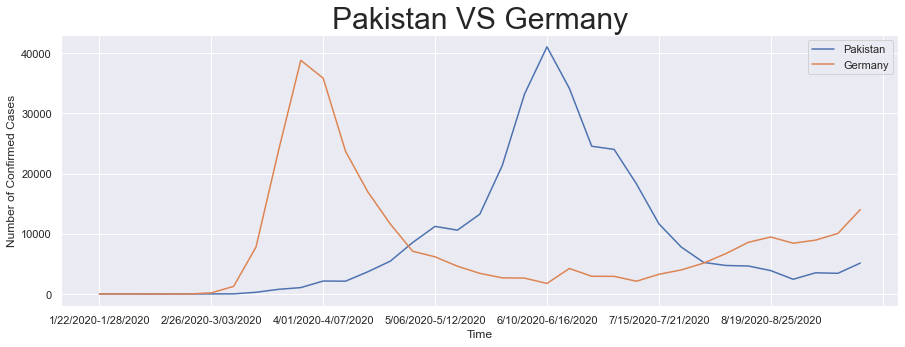

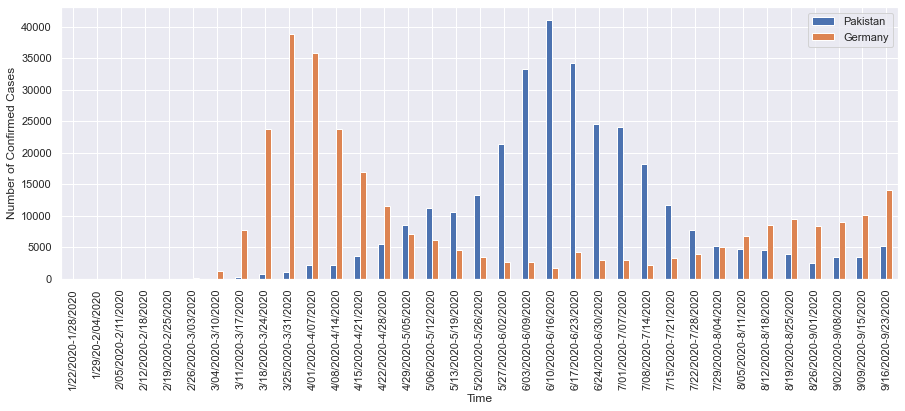

In [43]:
# Pakistan and Germany DataFrame 
Pakistan_Germany = pd.DataFrame(confirmed_weekly[130:131])
Pakistan_Germany = Pakistan_Germany.append(confirmed_weekly[66:67])
Pakistan_Germany = Pakistan_Germany.T

# Plot grouped by week
Pakistan_Germany_plot = Pakistan_Germany[1:].plot(figsize=(15, 5))
#### Graph Design

# Change the legend of the line plot
plt.legend(['Pakistan', 'Germany'])

#Add title
plt.title(label = 'Pakistan VS Germany', 
          size = 30)

# Add labels to the line plot
plt.xlabel('Time')
plt.ylabel('Number of Confirmed Cases')

#####################################################################################

# Histogram grouped by week
Pakistan_Germany_plot = Pakistan_Germany[1:].plot(figsize=(15, 5), kind = 'bar')

# Change the legend of the histogram
plt.legend(['Pakistan', 'Germany'])

# Add labels to the histogram
plt.xlabel('Time')
plt.ylabel('Number of Confirmed Cases')

SERCAN's PLOTS
Israel vs Austria
Austria and Israel relatively have same size and population. Below is the Covid response comparison of these countries and their disease counts. These 2 countries had a rapid response after Covid had been declared a global pandemic. Both country has 9 million population. Israel was one of the first country that had issued the travel ban to China which was 30 of january and all country went to lock down at March under a week. Mitigations were swift and rapid laws and quarantine created actually safe spot for Israel. According to information that we have about governmental regulations firt wave of Covid was smooth because of the strict state laws passed fast. Same situation happened in Austria also. The country went shut down and issued travel ban to far east and Italy. They also applied a lockdown for one of their own towns which is border neighbour of Italy. The data shows that possibly because of both countries mitigations, both country had a smooth first wave.

Text(0, 0.5, 'Number of Confirmed Cases')

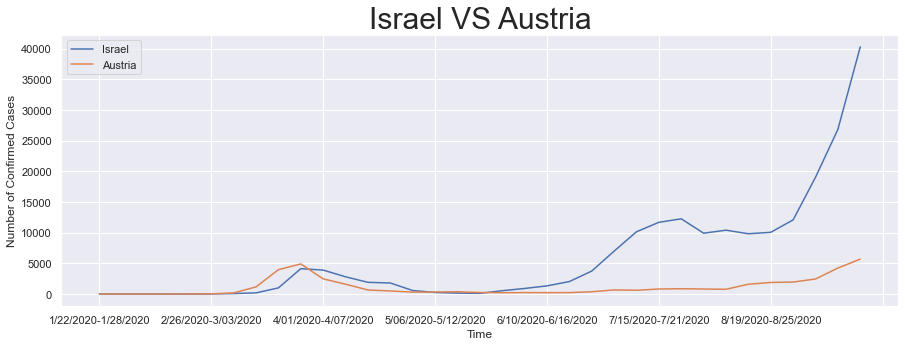

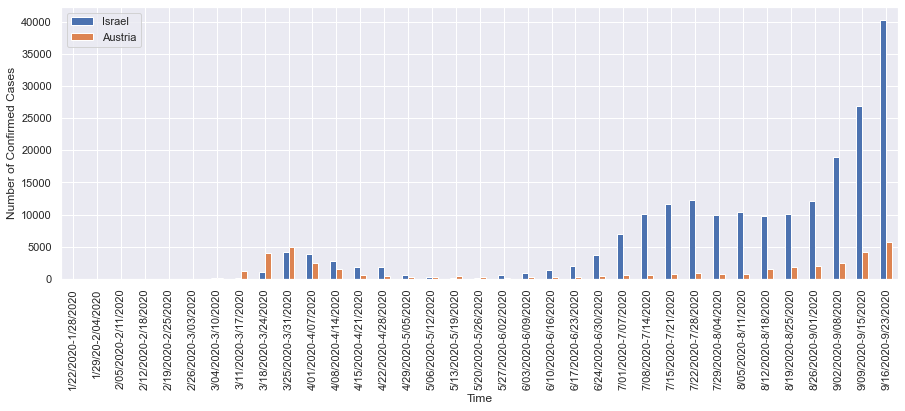

In [44]:
# Israel and Austria DataFrame
Israel_austria = pd.DataFrame(confirmed_weekly[84:85])
Israel_austria = Israel_austria.append(confirmed_weekly[9:10])
Israel_austria = Israel_austria.T

# Plot grouped by week
Israel_austria_plot = Israel_austria[1:].plot(figsize=(15, 5))

# Change the legend of the line plot
plt.legend(['Israel', 'Austria'])

#Add title
plt.title(label = 'Israel VS Austria', 
          size = 30)

# Add labels to the line plot
plt.xlabel('Time')
plt.ylabel('Number of Confirmed Cases')

#####################################################################################

# Histogram grouped by week
Israel_austria_plot = Israel_austria[1:].plot(figsize=(15, 5), kind = 'bar')

# Change the legend of the histogram
plt.legend(['Israel', 'Austria'])

# Add labels to the histogram
plt.xlabel('Time')
plt.ylabel('Number of Confirmed Cases')

Denmark vs Finland
Denmark and Finland are both nordic countries and have similar low population density. They also have similar economic structure. For Denmark containment measures were started as warnings and advices in the beginning of March. After 16 of March state started to issue laws to prevent wide spread of the virus. If we look at the graph of Denmark it has a rapid rise at the beginning of March and peak at April. After the rules the numbers started to drop. On the other hand Finland has a smoother transition on first of march. According to data their response was sharp on the second week of March and started to lock down for country in one day with all the possible prevention laws passed at 16 th of March. However there is a missing link in the data. Denmark gave permission to University Hospitals and drive thrue control centers to do Covid19 testing. So basicly number of testing facilities were much higher in Denmark than in Finland. That situation could explain the high difference of Covid 19 patience between those two countries. Covid 19 numbers are limited to tested number of people. Denmark had more tests for their folk and Finland had limited testing facilities. Althought the mitigations seems to drop the number of new covid patiences. It is safe to say that without containment measures the Covid postive numbers would be exponential.

Text(0, 0.5, 'Number of Confirmed Cases')

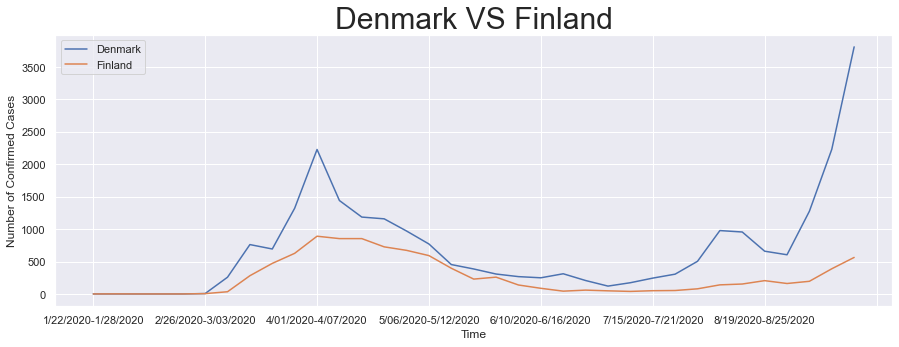

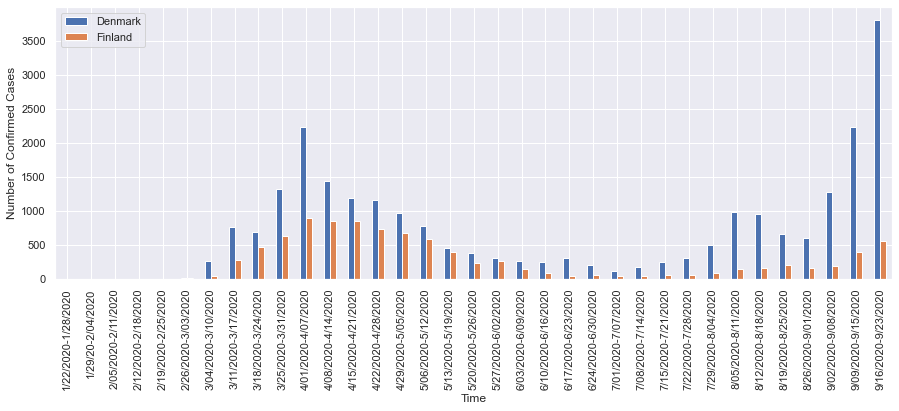

In [45]:
# Denmark and Finland DataFrame
Denmark_Finland = pd.DataFrame(confirmed_weekly[47:48])
Denmark_Finland = Denmark_Finland.append(confirmed_weekly[61:62])
Denmark_Finland = Denmark_Finland.T

# Plot grouped by week
Denmark_Finland_plot = Denmark_Finland[1:].plot(figsize=(15, 5))

# Change the legend of the line plot
plt.legend(['Denmark', 'Finland'])

#Add title
plt.title(label = 'Denmark VS Finland', 
          size = 30)

# Add labels to the line plot
plt.xlabel('Time')
plt.ylabel('Number of Confirmed Cases')

#####################################################################################

# Histogram grouped by week
Denmark_Finland_plot = Denmark_Finland[1:].plot(figsize=(15, 5), kind = 'bar')

# Change the legend of the histogram
plt.legend(['Denmark', 'Finland'])

# Add labels to the histogram
plt.xlabel('Time')
plt.ylabel('Number of Confirmed Cases')

Switzerland vs Sweeden
Switzerland and Sweden have same population, which makes them a good matchup to compare. Same population countries comparison helps us to keep the frequency stable. so by choosing countries with the same population, same socio-politic structure and economic level helps us to see more clearly if the containment measures and mitigations worked. Also comparisons of the countries chosen by their behaviour over the global pandemic. They have same measures except the responses to the pandemic. In EU Sweden was a failure to respond. State took its time to put a ban to travel and also have really advice based approach. That is why EU decided to close the Swedish border enterance. Swedish government decided to test only hospitilized people until end of march. That is why Covid 19 patient numbers start low but has a constant and stable increase. They are basicly have never done with the first wave until July. After serious considerations Swedish government increased containment measures rapidly in the beginning of April including quarantine and lockdowns. It is correct to say that half of the data come from hospitalized petience which makes it biased. The unbiased table would have much higher numbers for Sweden. If we look at the Switzerland, there is an important issue on the countries situation. From the containment measures we can see that Switzerland acted rapidly but the problem was interstate travel between Italy and Switzerland. There are a lot of work force daily moving between countries, so when the country started testing people, the numbers were really high. But thanks to their containment measures and closed borders they could be able to drop the numbers.

Text(0, 0.5, 'Number of Confirmed Cases')

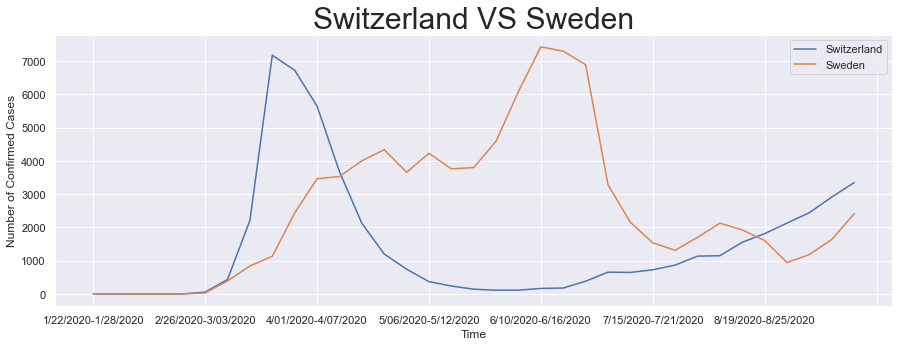

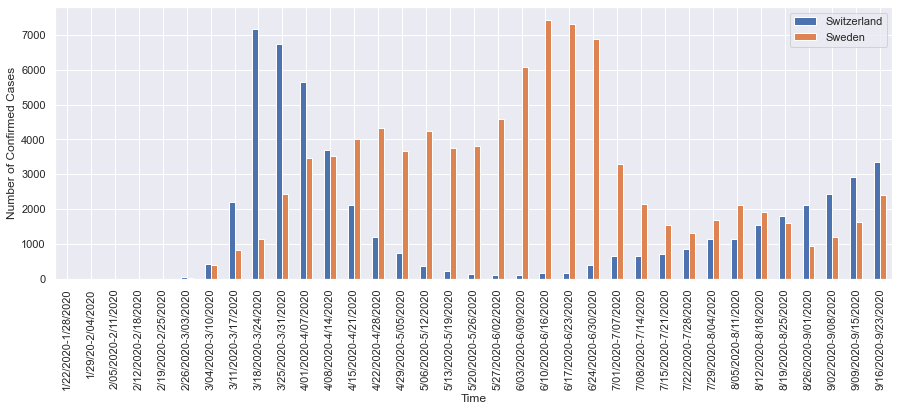

In [46]:
# Switzerland and Sweden DataFrame
Switzerland_sweden = pd.DataFrame(confirmed_weekly[163:164])
Switzerland_sweden = Switzerland_sweden.append(confirmed_weekly[162:163])
Switzerland_sweden = Switzerland_sweden.T

# Plot grouped by week
Switzerland_sweden_plot = Switzerland_sweden[1:].plot(figsize=(15, 5))

# Change the legend of the line plot
plt.legend(['Switzerland', 'Sweden'])

#Add title
plt.title(label = 'Switzerland VS Sweden', 
          size = 30)

# Add labels to the line plot
plt.xlabel('Time')
plt.ylabel('Number of Confirmed Cases')

#####################################################################################

# Histogram grouped by week
Switzerland_sweden_plot = Switzerland_sweden[1:].plot(figsize=(15, 5), kind = 'bar')

# Change the legend of the histogram
plt.legend(['Switzerland', 'Sweden'])

# Add labels to the histogram
plt.xlabel('Time')
plt.ylabel('Number of Confirmed Cases')

UK vs Germany
UK and Germany basicly have same population, social status, economics and social culture. There are several differences of these two countries containment measures. Although Germany had more restrictive and rapid response than UK countries Covid data looks really similar. Germany's response started in the beginning of February with tracking the covid possible patients. From that day they had many mitigations and restrictions issued day by day and finally they could be able to make the curve face downwards. However UK started mitigations oat March. According to data the only mitigation measure that UK have done best was the canceling the air travel before starting all the containment process. Because UK is an island that measure actually helped them more than any other country in the world. They went to a lockdown nd could contain the situation semi easly. In the second week of march real measurements had started and containment and decrease became possible.



Text(0, 0.5, 'Number of Confirmed Cases')

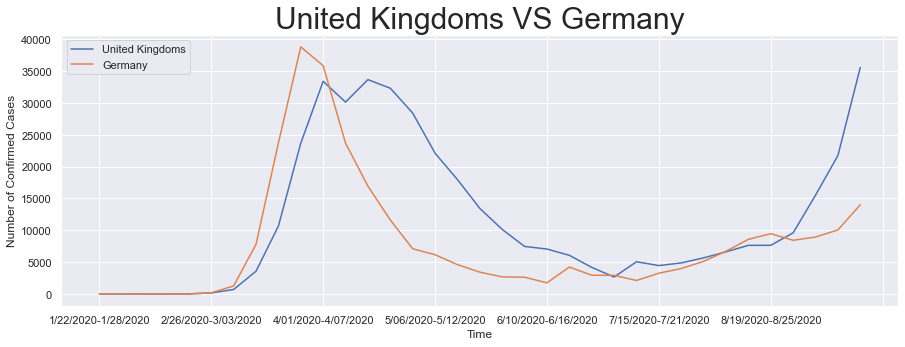

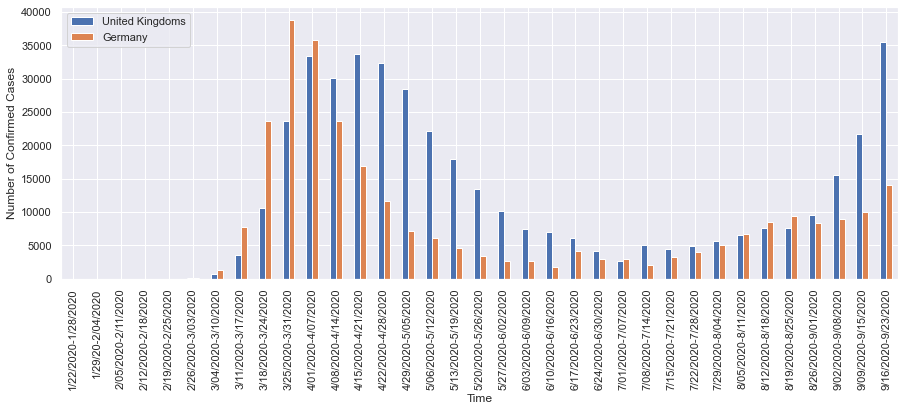

In [47]:
# UK and Germany DataFrame
UK_Germany = pd.DataFrame(confirmed_weekly[178:179])
UK_Germany = UK_Germany.append(confirmed_weekly[66:67])
UK_Germany = UK_Germany.T

# Plot grouped by week
UK_Germany_plot = UK_Germany[1:].plot(figsize=(15, 5))

# Change the legend of the line plot
plt.legend(['United Kingdoms', 'Germany'])

#Add title
plt.title(label = 'United Kingdoms VS Germany', 
          size = 30)

# Add labels to the line plot
plt.xlabel('Time')
plt.ylabel('Number of Confirmed Cases')

#####################################################################################

# Histogram grouped by week
UK_Germany_plot = UK_Germany[1:].plot(figsize=(15, 5), kind = 'bar')

# Change the legend of the histogram
plt.legend(['United Kingdoms', 'Germany'])

# Add labels to the histogram
plt.xlabel('Time')
plt.ylabel('Number of Confirmed Cases')